In [15]:
import numpy as np
global np
import scipy as sp
import scipy.signal as signal
import matplotlib.pyplot as plt
import IPython.display as ipd
from ipywidgets import interact
import sys
import wave
sys.path.append("../backend/")
%matplotlib inline
def load_wav(filepath, t_start = 0, t_end = sys.maxint) :
    """Load a wave file, which must be 22050Hz and 16bit and must be either
    mono or stereo. 
    Inputs:
        filepath: audio file
        t_start, t_end:  (optional) subrange of file to load (in seconds)
    Returns:
        a numpy floating-point array with a range of [-1, 1]
    """
    wf = wave.open(filepath)
    num_channels, sampwidth, fs, end, comptype, compname = wf.getparams()
    
    # for now, we will only accept 16 bit files at 22k
    assert(sampwidth == 2)
    assert(fs == 22050)

    # start frame, end frame, and duration in frames
    f_start = int(t_start * fs)
    f_end = min(int(t_end * fs), end)
    frames = f_end - f_start

    wf.setpos(f_start)
    raw_bytes = wf.readframes(frames)
    # convert raw data to numpy array, assuming int16 arrangement
    samples = np.fromstring(raw_bytes, dtype = np.int16)

    # convert from integer type to floating point, and scale to [-1, 1]
    samples = samples.astype(np.float)
    samples *= (1 / 32768.0)

    if num_channels == 1:
        return samples

    elif num_channels == 2:
        return 0.5 * (samples[0::2] + samples[1::2])

    else:
        raise('Can only handle mono or stereo wave files') 

# Modulation
What is modulation?
The idea is simple, we have a signal of information that we wish to convey, but we need a way to optimally deliver it over a given medium. For example, with radios we have all of this audio frequency content, but having all of it transmit in the audible range would result in a garbabled mess. So we want to move the audio content into other frequency ranges.

For today this is the audio I will be using:

In [40]:
audioFileDir = str("./Audio/Sir Duke Stevie Wonder.wav")
signal = load_wav(audioFileDir)
ipd.Audio(signal,rate=22050)

You can change it by changing the string variable to point towards your own audio on your own system.

# Amplitude Modulation

Suppose we have some audio that we want to transmit at a given carrier frequency. As we have mentioned before we can use the heterodyning principle in order to get push that audio conctent to the desired carrier frequency.

(5127419,)


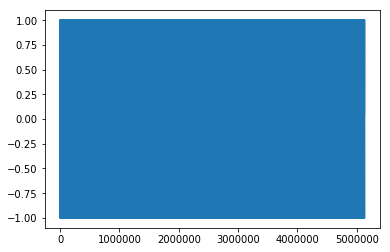

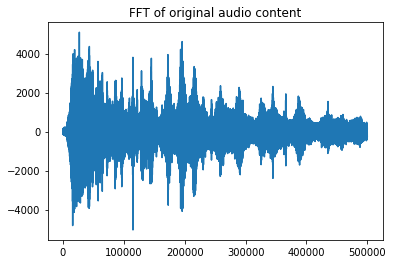

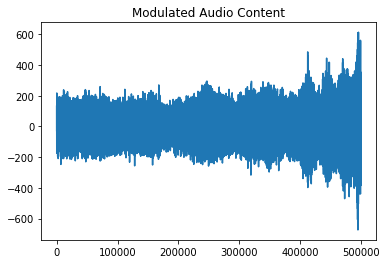

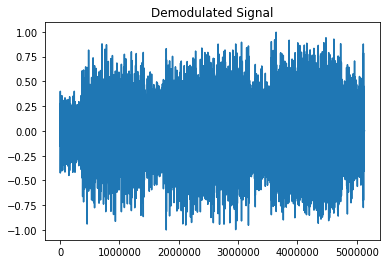

In [45]:
def amplitudemodulationDemo(wc=1):
    audiofft = np.fft.rfft(signal)
    print signal.shape
    t = np.linspace(0,signal.shape[0],signal.shape[0])
    cosine = np.cos(2*np.pi*wc*t)
    modulated = np.multiply(signal,cosine)
    ipd.Audio(modulated,rate=22050) #play the audio frequency content of this modulated signal. 
    fftmod = np.fft.rfft(modulated)
    plt.figure()
    plt.plot(cosine)
    plt.show()
    plt.figure()
    plt.plot(audiofft[:500000])
    plt.title("FFT of original audio content")
    plt.show()
    plt.figure()
    plt.plot(fftmod[:500000])
    plt.title("Modulated Audio Content")
    plt.show()
    #Demodulate the signal
    demod = np.multiply(modulated,cosine)
    plt.figure()
    plt.plot(demod)
    plt.title("Demodulated Signal")
    plt.show()
    return demod
    
demodulatedaudio = amplitudemodulationDemo(wc=int(4000*len(signal)/22050.))

In [43]:
ipd.Audio(demodulatedaudio,rate=22050)

To demodulate this signal we can multiply by a cosine in the same way that we did to modulate the audio content.

# Frequency Modulation

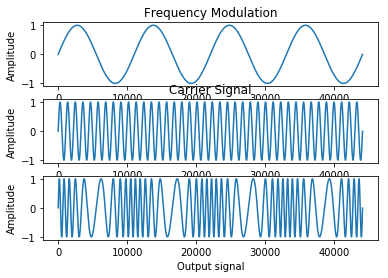

In [47]:
def frequencymodulationDemo():
    modulator_frequency = 4.0
    carrier_frequency = 40.0
    modulation_index = 1.0

    time = np.arange(44100.0) / 44100.0
    modulator = np.sin(2.0 * np.pi * modulator_frequency * time) * modulation_index
    carrier = np.sin(2.0 * np.pi * carrier_frequency * time)
    product = np.zeros_like(modulator)

    for i, t in enumerate(time):
        product[i] = np.sin(2. * np.pi * (carrier_frequency * t + modulator[i]))

    plt.subplot(3, 1, 1)
    plt.title('Frequency Modulation')
    plt.plot(modulator)
    plt.ylabel('Amplitude')
    plt.xlabel('Modulator signal')
    plt.subplot(3, 1, 2)
    plt.plot(carrier)
    plt.title("Carrier Signal")
    plt.ylabel('Amplitude')
    #plt.xlabel('Carrier signal')
    plt.subplot(3, 1, 3)
    plt.plot(product)
    plt.ylabel('Amplitude')
    plt.xlabel('Output signal')
    plt.show()
    
frequencymodulationDemo()

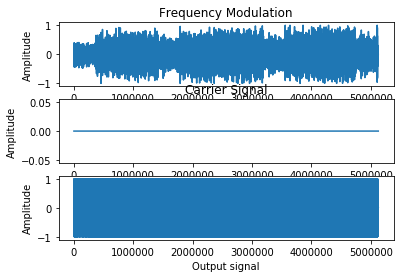

In [53]:
def frequencymodulation2Demo():
    modulator_frequency = 400.0
    carrier_frequency = 40.0
    modulation_index = 1.0

    time = np.arange(signal.shape[0]) / signal.shape[0]
    #modulator = np.sin(2.0 * np.pi * modulator_frequency * time) * modulation_index
    carrier = np.sin(2.0 * np.pi * carrier_frequency * time)
    product = np.zeros_like(signal)

    for i, t in enumerate(time):
        product[i] = np.sin(2. * np.pi * (carrier_frequency * t + signal[i]))

    plt.subplot(3, 1, 1)
    plt.title('Frequency Modulation')
    plt.plot(signal)
    plt.ylabel('Amplitude')
    plt.xlabel('Modulator signal')
    plt.subplot(3, 1, 2)
    plt.plot(carrier)
    plt.title("Carrier Signal")
    plt.ylabel('Amplitude')
    #plt.xlabel('Carrier signal')
    plt.subplot(3, 1, 3)
    plt.plot(product)
    plt.ylabel('Amplitude')
    plt.xlabel('Output signal')
    plt.show()
    return product
    
fmModulatedAudio=frequencymodulation2Demo()
ipd.Audio(fmModulatedAudio,rate=22050)

DEMODULATION FM

Some people have questions about why FM radio is so much more prevelent than AM radio.
One reason is that AM radio frequencies (~1MHz) have a weird atmospheric property that they are incredibly dependent upon the amount of EM waves hitting the atmosphere from the sun. So much so that during nighttime the AM radio waves from one station are able to broadcast all the way around the world. This is bad because one station in new zealand that plays death metal at 1MHz might interfer with with another station playing classical music at 1MHz from Boston. Thus, the way that this is resolved is that internationally and nationally there are agreements about which AM stations are allowed to play radio at what time. The FCC has an official publication on the matter:
https://www.fcc.gov/media/radio/am-stations-at-night. According to the FCC they no longer allow daytime-only radio stations as of December 1st, 1987, meaning that come nighttime new radio stations simply decerase their power to only service the local area.

From a technical point of fiew, frequency modulation has the following improvements over amplitude modulation.
# SLUDDS PUT THE TECHNICAL DETAILS HERE

# Phase Modulation

Phase modulation is 

In [5]:
def phasemodulationDemo():
    pass

After talk

The rest of these modulation methods are primily based on trying to transmit data/ messages. I will be choosing the below message. You can change it if you wish.

In [56]:
message = "C'est n'est pas une pipe" #It really isn't

# Amplitude Shift Keying

Amplitude Shift Keying

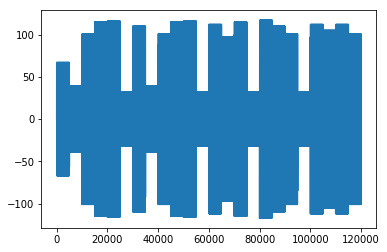

In [75]:
def amplitudeshiftkeyingDemo(message,f=1):
    time = np.arange(len(message)*5000.)/(len(message)*5000.)
    carrier = np.sin(2*np.pi*f*time)
    for i,value in enumerate(message):
        carrier[5000*i:5000*(i+1)] = ord(value)*carrier[5000*i:5000*(i+1)]
    plt.figure()
    plt.plot(carrier)
    plt.show()
    return carrier
    
returnedsignal = amplitudeshiftkeyingDemo(message,f=1000.)

In [80]:
def amplitudeshiftkeyingdemodDemo(carrier,f):
    maxvalues = []
    for i in range(int(len(returnedsignal)/5000)):
        maxvalues.append(max(returnedsignal[5000*i:5000*(i+1)]))
    returnmessage = ''
    for i in maxvalues:
        returnmessage += str(chr(int(i)))
    print returnmessage
amplitudeshiftkeyingdemodDemo(returnedsignal,f=1000.)

C'est n'est pas une pipe


So, we see that amplitude shift keying works well, and seems reasonably intuitive. Let's talk about some of the details of implementing this type of modulation.

# Frequency Shift Keying

Frequency Shift Keying is

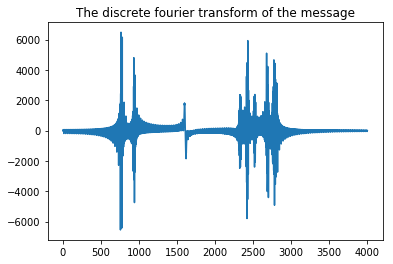

In [89]:
def frequencyshiftkeyingDemo(message):
    time = np.arange(5000.)/(5000.)
    returnable = np.zeros(5000*len(message))
    for index,value in enumerate(message):
        returnable[index*5000:(index+1)*5000] = np.sin(2*np.pi*ord(value)*time)
    plt.figure()
    plt.plot(np.fft.rfft(returnable)[0:4000])
    plt.title("The discrete fourier transform of the message")
    plt.show()
    return returnable
modulatedmessage = frequencyshiftkeyingDemo(message)

Help on function spectrogram in module scipy.signal.spectral:

spectrogram(x, fs=1.0, window=('tukey', 0.25), nperseg=None, noverlap=None, nfft=None, detrend='constant', return_onesided=True, scaling='density', axis=-1, mode='psd')
    Compute a spectrogram with consecutive Fourier transforms.
    
    Spectrograms can be used as a way of visualizing the change of a
    nonstationary signal's frequency content over time.
    
    Parameters
    ----------
    x : array_like
        Time series of measurement values
    fs : float, optional
        Sampling frequency of the `x` time series. Defaults to 1.0.
    window : str or tuple or array_like, optional
        Desired window to use. See `get_window` for a list of windows
        and required parameters. If `window` is array_like it will be
        used directly as the window and its length must be nperseg.
        Defaults to a Tukey window with shape parameter of 0.25.
    nperseg : int, optional
        Length of each segment. Def

TypeError: Image data cannot be converted to float

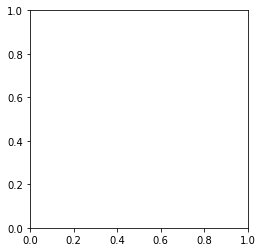

In [97]:
def frequencyshiftkeyingdemodDemo(modulatedmessage):
    stft = sp.signal.spectrogram(modulatedmessage,fs=22050)
    plt.figure()
    plt.imshow(stft)
    plt.show()
    
help(sp.signal.spectrogram)
frequencyshiftkeyingdemodDemo(modulatedmessage)

yes

## Phase Shift Keying

In [82]:
def phaseshiftkeyingdemo():
    pass

yes

# Quadrature Amplitude Modulation

Quadrature Amplitude Modulation (QAM) is

In [10]:
def qamDemo():
    pass

yes

# Quadrature Phase Shift Keying

Quadrature Phase Shift Keying

In [12]:
def qpskDemo():
    pass

yes